# Simulating a green golden rule

This notebook features a replication of the simulation of investment effects under a green golden rule, descirbed in [Annex 1](https://www.bruegel.org/sites/default/files/private/2024-06/Annexes.pdf) of ["A Quantitative Evaluation of the European Commission´s Fiscal Governance Proposal"](https://www.bruegel.org/working-paper/quantitative-evaluation-european-commissions-fiscal-governance-proposal) by Zsolt Darvas, Lennard Welslau, and Jeromin Zettelmeyer (2023).

The new fiscal framework could have been made more investment-friendly by introducing a rule that would have exempted Council-approved public investment (public investment justifying an extension of the adjustment period) from the application of the safeguards and the minimum adjustment requirement under the deficit-based EDP. The DSA requirements and the requirement to lower or keep the deficit below 3 percent of GDP would continue to apply (hence, we speak of ‘a fiscally responsible public investment rule’).

We simulate the impact of such temporary 0.5 percent of GDP extra investment for a period of six years (2025-2030) for the twelve EU countries that are expected to have higher than 60 percent of GDP public debt ratios in 2024 (Figure 1). We present a baseline scenario (without a new public investment programme) and an investment scenario with a temporary new investment programme. The net surplus in investment relative to the baseline scenario in the twelve countries would amount to 2.7 percent of annual GDP or about €407 billion in total over the six-year period. For the entire EU, net additional investment would amount to 2.8 percent of annual GDP or about €566 billion, in total over the six-year period.

The figure we create below shows that the debt ratio trajectories of even high-debt countries do not change much. The debt ratio under the temporary investment scenario is projected to decline a few years later than without the extra investment, yet the pace of debt reduction is almost identical. These calculations demonstrate that a rule of this type could be instrumental in facilitating the green transition, although it is consistent with the sustainability of public debt.

For comments and suggestions please contact lennard.welslau[at]gmail[dot]com. \
Last update: 01 June 2024

## Load DSA results created in "main.ipynb"

In [1]:
# Import libraries and modules
import numpy as np
import pandas as pd
pd.options.display.float_format = "{:,.3f}".format
pd.options.display.max_columns = 100
pd.options.display.max_rows = 100
import matplotlib.pyplot as plt
plt.rcParams.update({'axes.grid':True,'grid.color':'black','grid.alpha':'0.25','grid.linestyle':'--'})
plt.rcParams.update({'font.size': 14})

# Import DSA model class and stochastic subclass
import sys
import os
sys.path.append(os.path.abspath('..'))
from classes import *
from functions import *

# Set autoreleoad
%load_ext autoreload
%autoreload 2

In [ ]:
# Define list of EU codes for the DSA loop
eu_codes = [
    'AUT', 'BEL', 'BGR', 'HRV', 'CYP', 'CZE', 'DNK', 'EST', 'FIN', 
    'FRA', 'DEU', 'GRC', 'HUN', 'IRL', 'ITA', 'LVA', 'LTU', 'LUX', 
    'MLT', 'NLD', 'POL', 'PRT', 'ROU', 'SVK', 'SVN', 'ESP', 'SWE'
    ]
# Define adjustment periods for the DSA loop
adjustment_periods = [4, 7]

# Choose output folder and load results_dict (needs to be created in "main.ipynb")
folder_name = 'november_update'
results_dict = load_results_dict(folder_name)

{'AUT': {4: {'spb_target_dict': {'main_adjustment': 0.18749999999983147,
    'lower_spb': 0.6912999999998324,
    'financial_stress': 0.21029999999983223,
    'adverse_r_g': 0.7881999999998317,
    'deficit_reduction': -0.06840000000016933,
    'stochastic': 0.6550937206826746,
    'binding': 0.7881999999998317},
   'df_dict': {'main_adjustment':                 D      D_lt  D_lt_esm  D_new_lt  D_share_lt_maturing    D_st  \
    t  y                                                                           
    0  2023   371.100   347.162     0.000     0.000                0.108  23.938   
    1  2024   387.071   362.103     0.000    52.330                0.108  24.968   
    2  2025   402.523   376.558     0.000    53.302                0.107  25.965   
    3  2026   415.587   388.779     0.000    52.461                0.107  26.808   
    4  2027   427.886   400.285     0.000    52.889                0.106  27.601   
    5  2028   439.236   410.902     0.000    53.058                

### Simulate investment scenario

In [7]:
# Run investment scenario
run_inv_scenario(
    country_codes=eu_codes, 
    results_dict=results_dict, 
    folder_name=folder_name
    )

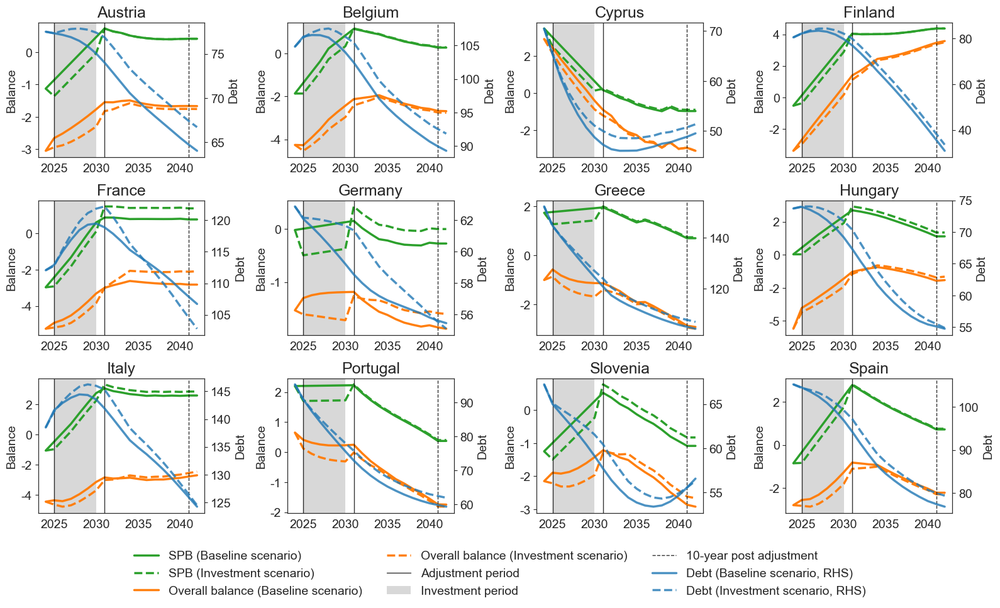

In [ ]:
# Define countries for investment plot
high_debt_countries = [
    'AUT', 'BEL', 'CYP', 'FIN', 
    'FRA', 'DEU', 'GRC', 'HUN', 
    'ITA', 'PRT', 'SVN', 'ESP'
    ]

# Plot investment scenario
plot_inv(
    country_codes=high_debt_countries, 
    results_dict=results_dict, 
    folder_name=folder_name, 
    nrows=3, 
    ncols=4, 
    save_svg=False, 
    save_png=True
    )